# Spatial Transcriptomics Cluster Validation for HM-OT

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np

import sys
import os
import importlib
os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
import torch
sys.path.append(os.path.abspath("../.."))

import src.HiddenMarkovOT as HiddenMarkovOT
import src.utils.util_LR as util_LR
from src.utils.util_LR import convert_adata
import src.plotting as plotting


In [2]:
import random

def seed_everything(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    os.environ['PYTHONHASHSEED'] = str(seed)
    return

seed_everything(42)

timepoints = [ 'E11.5', 'E12.5', 'E13.5'] 


In [3]:
filehandles_pca_pairs = [
    '/scratch/gpfs/ph3641/mouse_embryo/pca_pairs/embryo_pair_E11.5_E12.5.h5ad',
    '/scratch/gpfs/ph3641/mouse_embryo/pca_pairs/embryo_pair_E12.5_E13.5.h5ad'
]
adata_pairs = [sc.read_h5ad(fh) for fh in filehandles_pca_pairs]

from src.utils.util_LR import convert_adata_pairwise

# Set torch device (GPU if available)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Convert AnnData in HM-OT ready factors
C_factors_sequence, A_factors_sequence, Qs, labels, rank_list, spatial_list = convert_adata_pairwise(adata_pairs,
                                                                                    timepoints=timepoints,
                                                                                     timepoint_key = 'timepoint',
                                                                                     replicate_key = 'embryo_id',
                                                                                     feature_key = 'X_pca',
                                                                                     cell_type_key = 'annotation',
                                                                                     spatial = True,
                                                                                     spatial_key = ['x_loc', 'y_loc'],
                                                                                     fallback_spatial_key = 'spatial',
                                                                                     dist_eps = 0.02,
                                                                                     dist_rank = 100,
                                                                                     dist_rank_2 = 50,
                                                                                     device = device,
                                                                                    normalize=True
                                                                                )

/home/ph3641/.conda/envs/peterenv2/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/ph3641/.conda/envs/peterenv2/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [4]:
import pickle
import src.utils.clustering as clustering
from sklearn.metrics import adjusted_mutual_info_score as ami
from sklearn.metrics import adjusted_rand_score as ari

# Load using pickle
with open("matrices/spatial_list.pkl", "rb") as f:
    spatial_list = pickle.load(f)
with open("matrices/Qs_hmot_unsup.pkl", "rb") as f:
    Qs_hmot_unsup = pickle.load(f)
with open("matrices/Ts_hmot_unsup.pkl", "rb") as f:
    Ts_hmot_unsup = pickle.load(f)

Qs_ann = [Q.cpu().numpy() for Q in Qs][:-1]

clusterings_ann = clustering.max_likelihood_clustering(Qs_ann, mode='standard')

clusterings_hmot = clustering.reference_clustering(
                Qs = Qs_hmot_unsup,
                Ts = Ts_hmot_unsup,
                reference_index = 0
                )

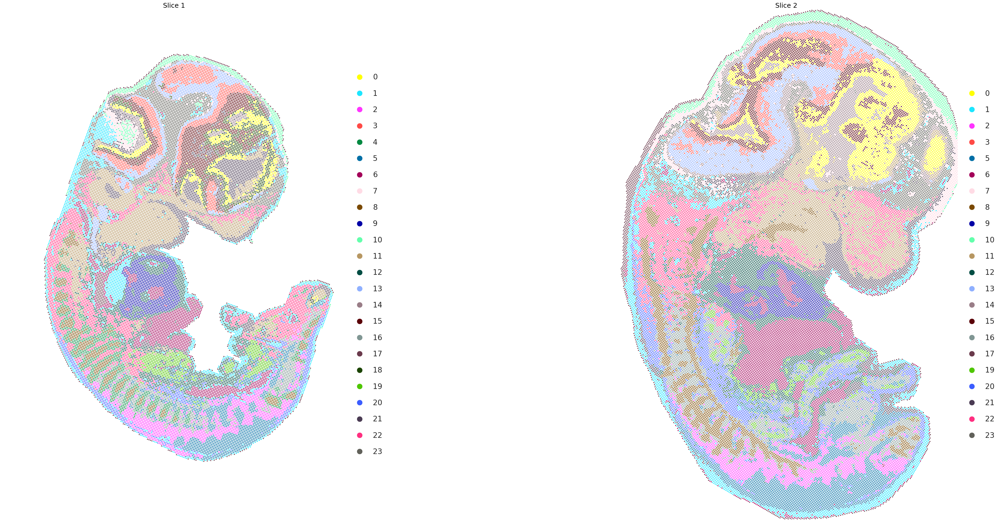

In [5]:
import importlib
importlib.reload(plotting)

# Visualize the transfer from time 1 to time 2
plotting.plot_clusters_from_QT(spatial_list[:-1], Qs_hmot_unsup,
                               Ts_hmot_unsup, None, clustering_type='reference',
                               reference_index=0, flip=True, dotsize=10,
                              save_name='ME_unsupervised_spatial_E115_E125.svg',
                              key_dotsize=0.3)


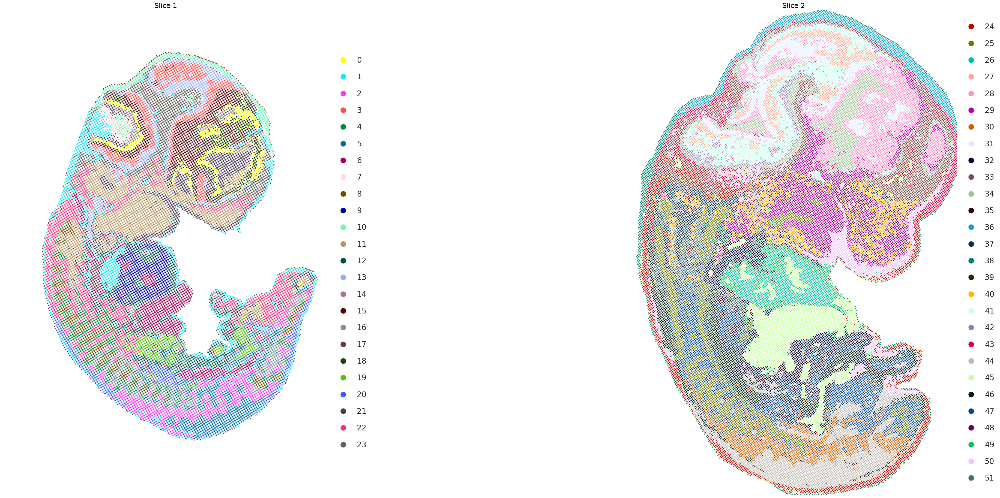

In [6]:
plotting.plot_clusters_from_QT(spatial_list[:-1], Qs_hmot_unsup,
                               Ts_hmot_unsup, None, flip=True, dotsize=10,
                              save_name='ME_unsupervised_spatial_E115_E125_ML.svg',
                              key_dotsize=0.3)

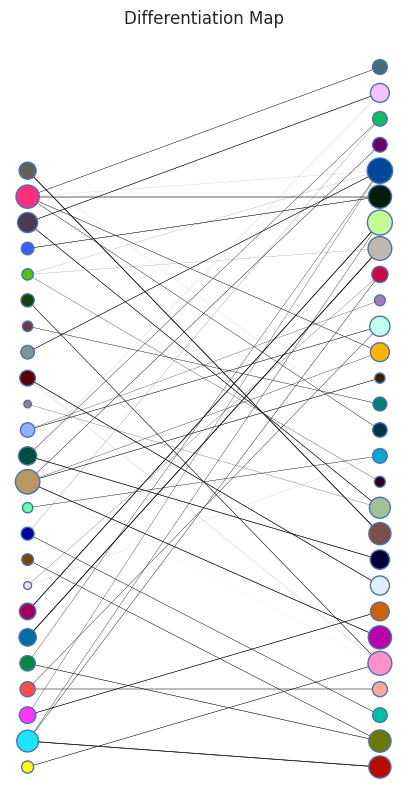

In [7]:

plotting.diffmap_from_QT(Qs_hmot_unsup, Ts_hmot_unsup,
                        dsf=0.1)


In [8]:
import pandas as pd


adata_11_5 = sc.read_h5ad('/scratch/gpfs/ph3641/mouse_embryo/E11.5_E1S1.MOSTA.h5ad')
adata_12_5 = sc.read_h5ad('/scratch/gpfs/ph3641/mouse_embryo/E12.5_E1S1.MOSTA.h5ad')

clus = clusterings_hmot

clus_idx = [1]

indices1_ann = np.where(np.isin(clusterings_ann[0], clus_idx))[0]
indices2_ann = np.where(np.isin(clusterings_ann[1], clus_idx))[0]

Q1 = Qs_ann[0]
Q2 = Qs_ann[1]

Q1_brain_ann = Q1[indices1_ann, :][:, clus_idx]
Q2_brain_ann = Q2[indices2_ann, :][:, clus_idx]

spatial_brain1_ann = spatial_list[0][indices1_ann]
spatial_brain2_ann = spatial_list[1][indices2_ann]

clus1_brain = clus[0][indices1_ann]
clus2_brain = clus[1][indices2_ann]

# HM-OT Brain Types
plotting.plot_clustering_list(
    spatial_list=[spatial_brain1_ann, spatial_brain2_ann],
    clustering_list=[clus1_brain, clus2_brain],
    clustering_type='reference',
    dotsize=20,
    flip=True,
    key_dotsize=0.3
)

clus1_brain_ann = clusterings_ann[0][indices1_ann]
clus2_brain_ann = clusterings_ann[1][indices2_ann]

# Annotated "Brain"
plotting.plot_clustering_list(
    spatial_list=[spatial_brain1_ann, spatial_brain2_ann],
    clustering_list=[clus1_brain_ann, clus2_brain_ann],
    clustering_type='reference',
    dotsize=20,
    flip=True
)


# Annotate brain clusters
adata_11_5.obs['brain_cluster'] = pd.NA
adata_12_5.obs['brain_cluster'] = pd.NA

adata_11_5.obs.loc[adata_11_5.obs.index[indices1_ann], 'brain_cluster'] = clus1_brain
adata_12_5.obs.loc[adata_12_5.obs.index[indices2_ann], 'brain_cluster'] = clus2_brain

adata_11_5.obs.loc[adata_11_5.obs.index[indices1_ann], 'brain_cluster_ann'] = clus1_brain_ann
adata_12_5.obs.loc[adata_12_5.obs.index[indices2_ann], 'brain_cluster_ann'] = clus2_brain_ann

adata_11_5_brain = adata_11_5[indices1_ann].copy()
adata_12_5_brain = adata_12_5[indices2_ann].copy()

# Cluster labels should be treated as categorical
adata_11_5_brain.obs['brain_cluster'] = adata_11_5_brain.obs['brain_cluster'].astype('category')
adata_12_5_brain.obs['brain_cluster'] = adata_12_5_brain.obs['brain_cluster'].astype('category')

adata_11_5_brain.obs['brain_cluster_ann'] = adata_11_5_brain.obs['brain_cluster_ann'].astype('category')
adata_12_5_brain.obs['brain_cluster_ann'] = adata_12_5_brain.obs['brain_cluster_ann'].astype('category')


In [9]:
import matplotlib.pyplot as plt
import src.validation.clustering_validation as cv

_common_cluster_labels = np.intersect1d(np.unique(clus1_brain), 
                                         np.unique(clus2_brain))
common_cluster_labels = []

# Basic filtering so number of co-occurring cells is significant and gives enough statistical power
thres = 500

for cluster_label in _common_cluster_labels:
    idx1 = np.where(clus1_brain == cluster_label)
    #idx2 = np.where(clus2_brain == cluster_label)
    if len(clus1_brain[idx1]) > thres: #and len(clus2_brain[idx2]) > thres:
        common_cluster_labels.append(cluster_label)

common_cluster_labels = np.array(common_cluster_labels)

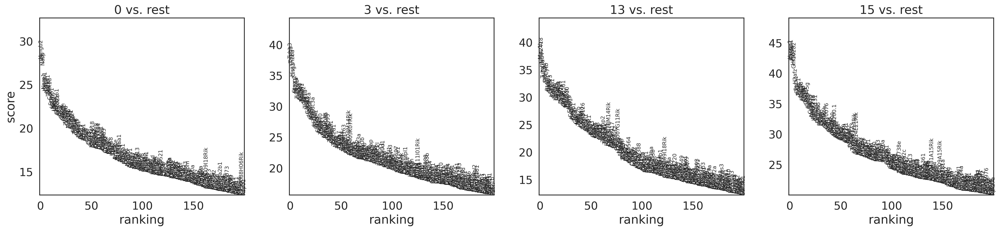

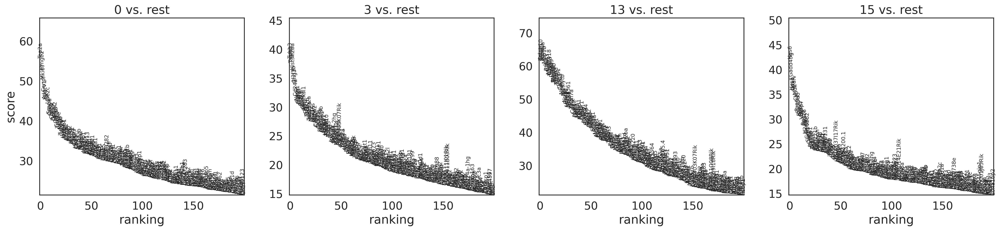


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [10]:
import src.validation.clustering_validation as cv
import importlib
importlib.reload(cv)

prolif_genes = ['Sox2',
                  'Mki67',
                  'Dek',
                  'Ccnd1',
                  'Eif4g1',
                  'Top2a',
                  'Tpx2',
                  'Ube2c',
                   'Ezh2',
                   'Hmga2'
               ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = prolif_genes
)


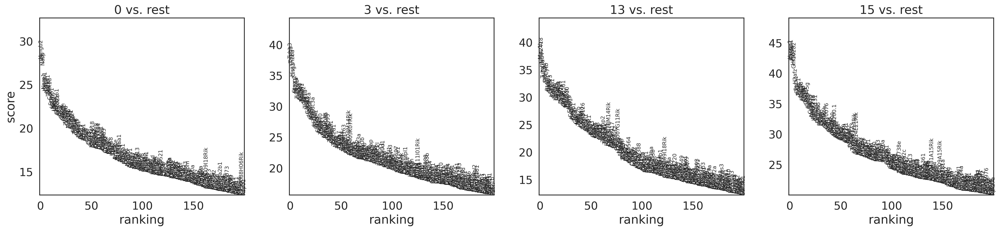

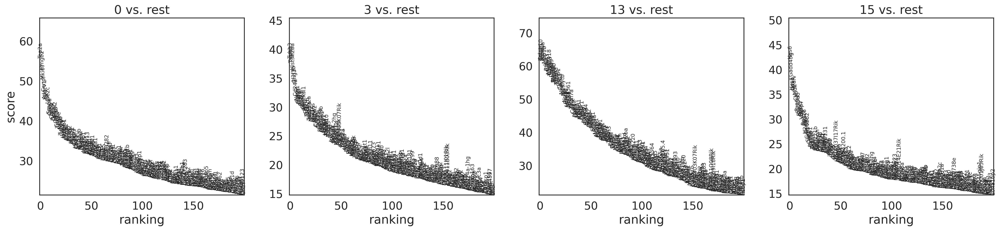


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [11]:

int_genes = ['Hes5',
            'Hes6',
            'Fabp7',
            'Vim',
            'Gadd45g',
            'Id3',
            'Tead2',
             'Tcf3'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = int_genes
)


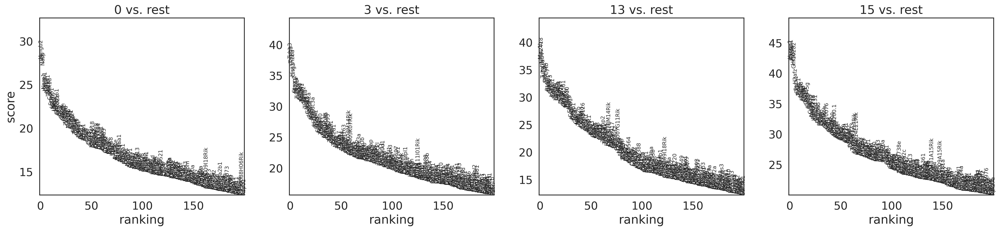

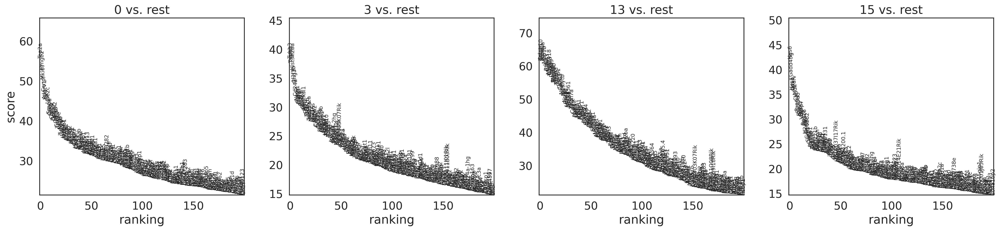


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [12]:

int_genes2 = ['Cd24a',
            'Stmn1/2',
            'Sox11',
             'Nsg1',
             'Bex2',
              'Elavl3',
              'Map2',
              'Dcx'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = int_genes2
)


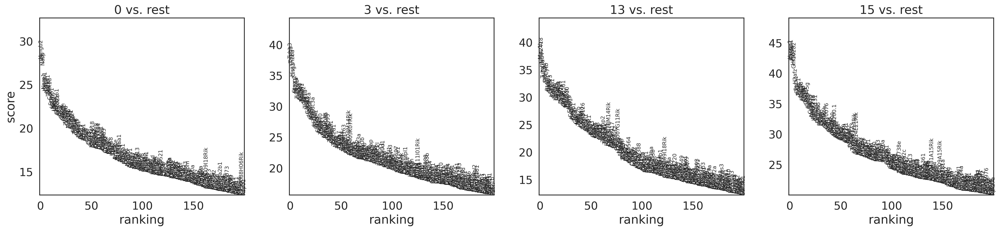

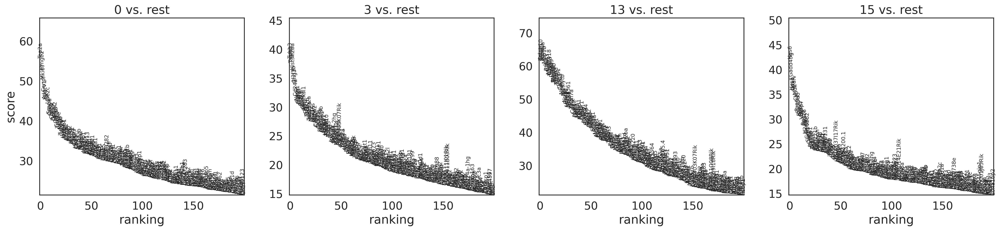


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [13]:

mat_genes = ['Nefm',
             'Tubb3',
             'Ina',
            'Map2',
             'Mapt',
             'Nefl',
             'Elavl3',
             'Uchl1',
             'mt-Co1',
             'Rab3a'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = mat_genes
)


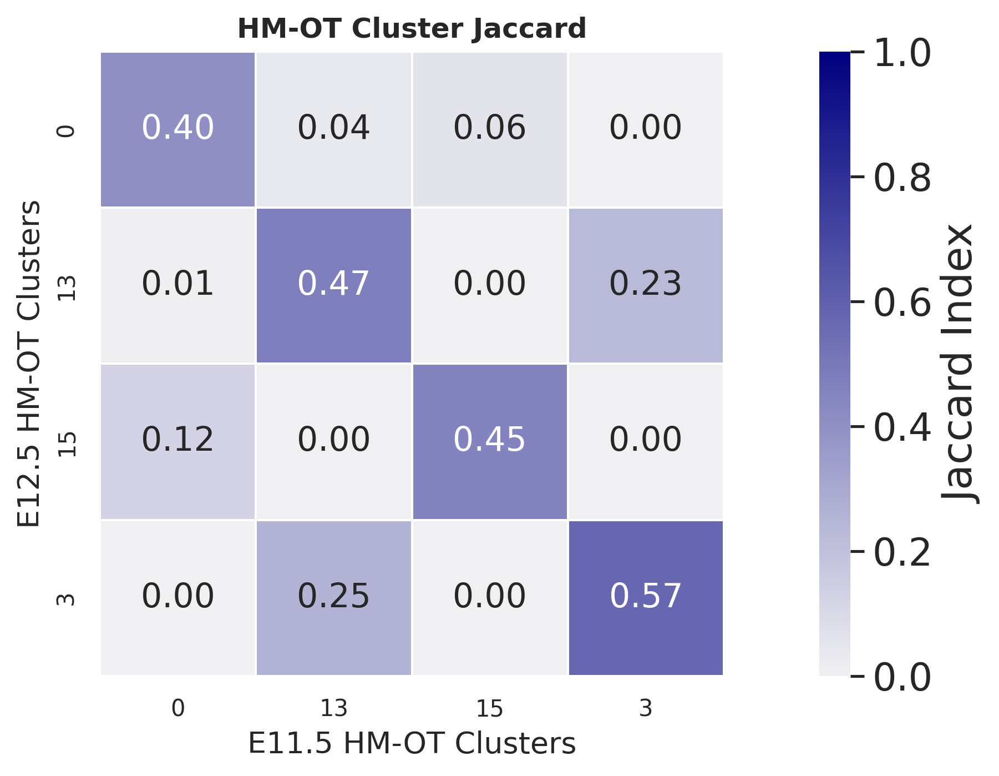

<Figure size 1920x1440 with 0 Axes>

In [14]:


fig, ax1 = plt.subplots(1, 1, figsize=(12, 5), dpi=300)

cv.plot_jaccard_matrix(J1, ax1, annot_text=True, title="HM-OT Cluster Jaccard",
                       x_lab='E11.5 HM-OT Clusters', y_lab='E12.5 HM-OT Clusters')

plt.tight_layout()
plt.show()

ax1.set_title("HM-OT Cluster Jaccard")

plt.tight_layout()
plt.show()


In [15]:

def get_AnnData_With_DE(adata_1, adata_2, 
                      clustering1, clustering2,
                     cluster_label='cluster',
                    overlap_lst=None,):
    """
    Computes a Jaccard similarity matrix between clusters at two timepoints
    based on overlap in top DE genes.

    Parameters:
    - adata_1, adata_2: AnnData objects at timepoints t1 and t2.
    - clustering1, clustering2: Cluster labels for each cell at t1 and t2.
    - cluster_label (str): Column name to store clusters in AnnData.obs.
    - n_top_genes (int): Number of top DE genes to consider.
    - print_DE (bool): If True, print intersecting DE genes and stats.
    - overlap_lst (list): Subset of clusters to compare.
    - genes_to_print (list): Specific genes to display if in DE list.

    Returns:
    - adata_1, adata_2: AnnData objects at timepoints t1 and t2 with DE statistics.
    """
    
    if overlap_lst is not None:
        
        mask1 = np.isin(clustering1, overlap_lst)
        mask2 = np.isin(clustering2, overlap_lst)
        adata1 = adata_1[mask1].copy()
        adata2 = adata_2[mask2].copy()
        clustering1 = np.array(clustering1)[mask1]
        clustering2 = np.array(clustering2)[mask2]
        
    else:
        adata1 = adata_1.copy()
        adata2 = adata_2.copy()
    
    adata1.obs[cluster_label] = clustering1
    adata2.obs[cluster_label] = clustering2
    
    sc.pp.normalize_total(adata1)
    sc.pp.log1p(adata1)
    sc.pp.normalize_total(adata2)
    sc.pp.log1p(adata2)
    
    adata1.obs[cluster_label] = adata1.obs[cluster_label].astype('category')
    adata2.obs[cluster_label] = adata2.obs[cluster_label].astype('category')
    
    sc.tl.rank_genes_groups(adata1, groupby=cluster_label, method='wilcoxon')
    sc.tl.rank_genes_groups(adata2, groupby=cluster_label, method='wilcoxon')
    
    sc.pl.rank_genes_groups(adata1,
                            sharey=False, title='t1 DE')
    sc.pl.rank_genes_groups(adata2,
                            sharey=False, title='t2 DE')
    
    return adata1, adata2


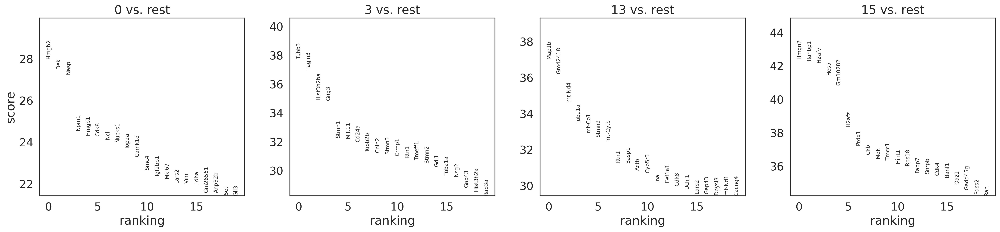

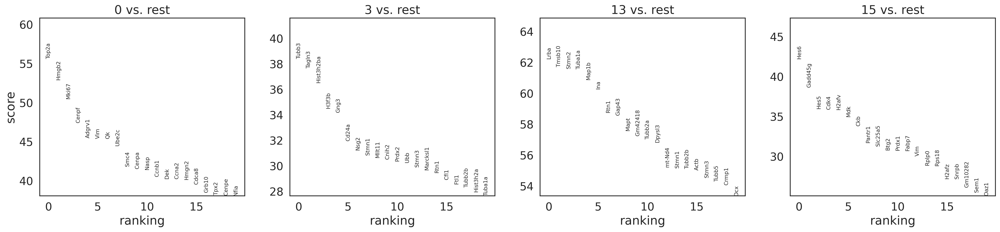

In [16]:
# 0) get your processed AnnData with DE already computed
ad1, ad2 = get_AnnData_With_DE(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    overlap_lst=common_cluster_labels
)

ad = ad2.copy()
ad.obs['brain_cluster'] = ad.obs['brain_cluster'].astype(str).astype('category')


In [17]:
growth_genes = [
  'Sox2','Mki67','Dek','Ccnd1','Eif4g1',
  'Top2a','Tpx2','Ube2c','Ezh2','Hmga2'
]
clusters = ['0', '15', '3', '13']

logfc_dict = {}
for c in clusters:
    df = sc.get.rank_genes_groups_df(ad, group=c).set_index('names')
    logfc_dict[c] = df.loc[growth_genes, 'logfoldchanges']

logfc_df_growth = pd.DataFrame(logfc_dict, index=growth_genes)

growth_genes = [
  'Sox2','Mki67','Dek','Ccnd1','Eif4g1',
  'Top2a','Tpx2','Ube2c','Ezh2','Hmga2'
]
clusters = ['0', '15', '3', '13']

logfc_dict = {}
for c in clusters:
    df = sc.get.rank_genes_groups_df(ad, group=c).set_index('names')
    logfc_dict[c] = df.loc[growth_genes, 'logfoldchanges']

logfc_df_growth = pd.DataFrame(logfc_dict, index=growth_genes)

mat_genes = ['Nefm',
             'Tubb3',
             'Ina',
            'Map2',
             'Mapt',
             'Nefl',
             'Elavl3',
             'Uchl1',
             'mt-Co1',
             'Rab3a'
            ]

logfc_dict = {}
for c in clusters:
    df = sc.get.rank_genes_groups_df(ad, group=c).set_index('names')
    logfc_dict[c] = df.loc[mat_genes, 'logfoldchanges']

logfc_df_mat = pd.DataFrame(logfc_dict, index=mat_genes)


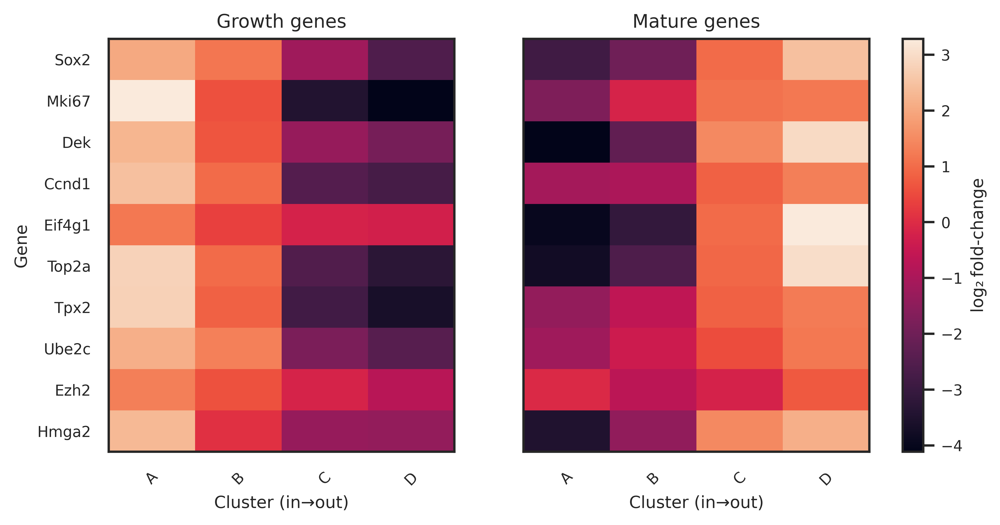

In [36]:
import matplotlib.pyplot as plt
import matplotlib as mpl

# 1) style
mpl.rcParams.update({ 
    "font.size": 9,
    "axes.titlesize": 10, "axes.labelsize": 9,
    "xtick.labelsize": 8, "ytick.labelsize": 8,
    "lines.linewidth": 1.2, "lines.markersize": 4,
    "figure.dpi": 600,
})


# 3) 1×2 heatmaps
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4),
                               gridspec_kw={'width_ratios': [1,1]})
for ax, df, title in zip((ax1, ax2),
                         (logfc_df_growth, logfc_df_mat),
                         ("Growth genes", "Mature genes")):
    im = ax.imshow(df.values, aspect="auto")
    ax.set_xticks(range(len(clusters)))
    ax.set_xticklabels(xtick_labels, rotation=45)
    ax.set_yticks(range(len(df.index)))
    ax.set_yticklabels(df.index if ax is ax1 else [])
    ax.set_title(title)
    ax.set_xlabel("Cluster (in→out)")
    if ax is ax1:
        ax.set_ylabel("Gene")

cbar = fig.colorbar(im, ax=(ax1, ax2),
                    fraction=0.046, pad=0.04)

cbar.set_label("log₂ fold-change")
#plt.tight_layout()
plt.savefig("fig_heatmaps.pdf", bbox_inches="tight")


In [ ]:

# 4) 1×2 line plots
fig, (ax3, ax4) = plt.subplots(1, 2, figsize=(8,3),
                               sharey=True)
for ax, df, title in zip(
        (ax3, ax4),
        (logfc_df_growth, logfc_df_mat),
        ("Proliferation genes", "Mature neuronal genes")):
    
    for gene in df.index:
        ax.plot(clusters, df.loc[gene],
                marker='o', label=gene)
    ax.set_xticks(clusters)
    ax.set_xticklabels(xtick_labels)
    ax.set_xlabel("(Inner Layer → Outer Layer)")
    if ax is ax3:
        ax.set_ylabel("log₂ fold-change")
    ax.set_title(title)
    ax.legend(fontsize='x-small', ncol=2,
              loc='upper center',
              bbox_to_anchor=(0.5, -0.5),
              frameon=False)

#plt.tight_layout() #rect=[0,0.1,1,1]
plt.savefig("fig_lineplots.pdf", bbox_inches="tight")

/tmp/ipykernel_1526765/4131708942.py:30: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


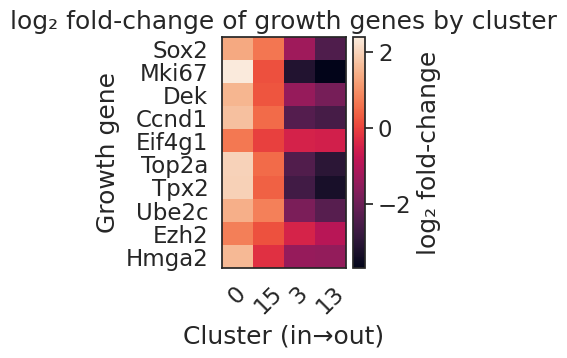

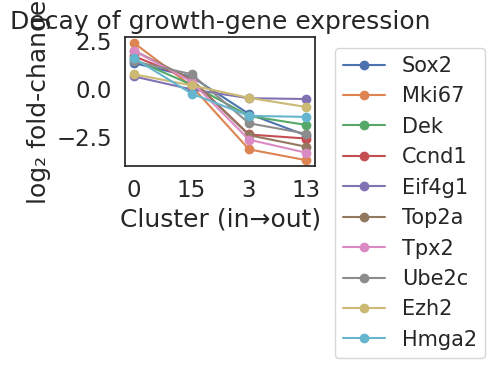

/tmp/ipykernel_1526765/4131708942.py:80: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


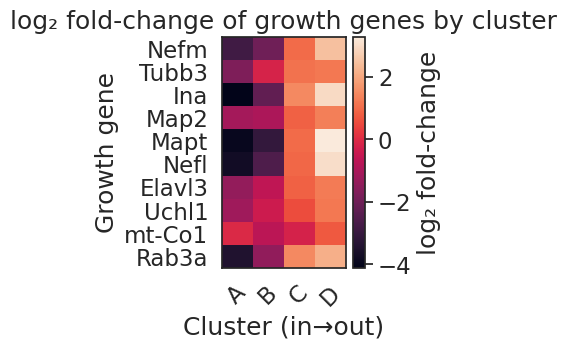

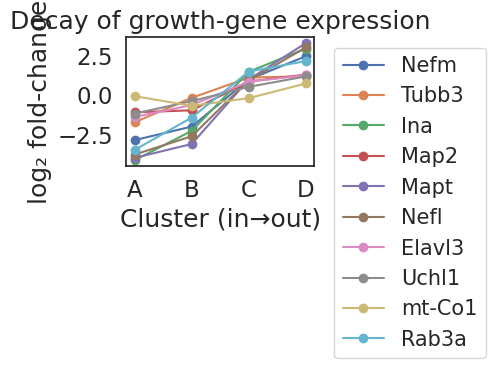

In [33]:
'''
import pandas as pd
import matplotlib.pyplot as plt

growth_genes = [
  'Sox2','Mki67','Dek','Ccnd1','Eif4g1',
  'Top2a','Tpx2','Ube2c','Ezh2','Hmga2'
]
clusters = ['0', '15', '3', '13']

logfc_dict = {}
for c in clusters:
    df = sc.get.rank_genes_groups_df(ad, group=c).set_index('names')
    logfc_dict[c] = df.loc[growth_genes, 'logfoldchanges']

logfc_df = pd.DataFrame(logfc_dict, index=growth_genes)

# heatmap
fig, ax = plt.subplots(
    figsize=(len(clusters)*0.5, len(growth_genes)*0.3), dpi=100
)
im = ax.imshow(logfc_df.values, aspect='auto')
ax.set_xticks(range(len(clusters)))
ax.set_xticklabels(clusters, rotation=45)
ax.set_yticks(range(len(growth_genes)))
ax.set_yticklabels(growth_genes)
ax.set_xlabel("Cluster (in→out)")
ax.set_ylabel("Growth gene")
ax.set_title("log₂ fold-change of growth genes by cluster")
fig.colorbar(im, ax=ax, label="log₂ fold-change")
plt.tight_layout()
plt.show()

# line plot
fig, ax = plt.subplots(figsize=(5,3), dpi=100)
for gene in growth_genes:
    ax.plot(clusters, logfc_df.loc[gene], marker='o', label=gene)
ax.set_xticks(clusters)
ax.set_xlabel("Cluster (in→out)")
ax.set_ylabel("log₂ fold-change")
ax.set_title("Decay of growth-gene expression")
ax.legend(bbox_to_anchor=(1.05,1), loc='upper left', fontsize='small')
plt.tight_layout()
plt.show()


mat_genes = ['Nefm',
             'Tubb3',
             'Ina',
            'Map2',
             'Mapt',
             'Nefl',
             'Elavl3',
             'Uchl1',
             'mt-Co1',
             'Rab3a'
            ]

clusters = ['0', '15', '3', '13']

logfc_dict = {}
for c in clusters:
    df = sc.get.rank_genes_groups_df(ad, group=c).set_index('names')
    logfc_dict[c] = df.loc[mat_genes, 'logfoldchanges']

logfc_df = pd.DataFrame(logfc_dict, index=mat_genes)

# heatmap
fig, ax = plt.subplots(
    figsize=(len(clusters)*0.5, len(mat_genes)*0.3), dpi=100
)
im = ax.imshow(logfc_df.values, aspect='auto')
ax.set_xticks(range(len(clusters)))
ax.set_xticklabels(['A', 'B', 'C', 'D'], rotation=45)
ax.set_yticks(range(len(mat_genes)))
ax.set_yticklabels(mat_genes)
ax.set_xlabel("Cluster (in→out)")
ax.set_ylabel("Growth gene")
ax.set_title("log₂ fold-change of growth genes by cluster")
fig.colorbar(im, ax=ax, label="log₂ fold-change")
plt.tight_layout()
plt.show()

# line plot
fig, ax = plt.subplots(figsize=(5,3), dpi=100)
for gene in mat_genes:
    ax.plot(clusters, logfc_df.loc[gene], marker='o', label=gene)
ax.set_xticks(clusters)
ax.set_xticklabels(['A', 'B', 'C', 'D'])
ax.set_xlabel("Cluster (in→out)")
ax.set_ylabel("log₂ fold-change")
ax.set_title("Decay of growth-gene expression")
ax.legend(bbox_to_anchor=(1.05,1), loc='upper left', fontsize='small')
plt.tight_layout()
plt.show()
'''



'''
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams.update({
    "figure.dpi": 600,
})
# assume these are your two DataFrames:
#   logfc_df_growth: growth_genes × clusters
#   logfc_df_mat:     mat_genes    × clusters

# parameters
clusters = ['0','15','3','13']
xtick_labels = ['A','B','C','D']  # for the mat_genes plot

# --- FIGURE 1: two heatmaps side by side ---
fig, (ax1, ax2) = plt.subplots(1, 2,
                               figsize=(8, 4),
                               dpi=100,
                               gridspec_kw={'width_ratios': [1,1]})

# growth heatmap
im1 = ax1.imshow(logfc_df_growth.values, aspect='auto')
ax1.set_xticks(range(len(clusters)))
ax1.set_xticklabels(xtick_labels, rotation=45)
ax1.set_yticks(range(len(logfc_df_growth.index)))
ax1.set_yticklabels(logfc_df_growth.index)
ax1.set_title("Growth genes")
ax1.set_xlabel("Cluster (in→out)")
ax1.set_ylabel("Gene")
fig.colorbar(im1, ax=ax1, fraction=0.046, pad=0.04, label="log₂ FC")

# mature heatmap
im2 = ax2.imshow(logfc_df_mat.values, aspect='auto')
ax2.set_xticks(range(len(clusters)))
ax2.set_xticklabels(xtick_labels, rotation=45)
ax2.set_yticks(range(len(logfc_df_mat.index)))
ax2.set_yticklabels(logfc_df_mat.index)
ax2.set_title("Mature genes")
ax2.set_xlabel("Cluster (in→out)")
# no ylabel on right plot
fig.colorbar(im2, ax=ax2, fraction=0.046, pad=0.04, label="log₂ FC")

plt.tight_layout()
plt.show()


# --- FIGURE 2: two line-plots side by side ---
fig, (ax3, ax4) = plt.subplots(1, 2,
                               figsize=(8, 3),
                               dpi=100,
                               sharey=True)

# growth lines
for gene in logfc_df_growth.index:
    ax3.plot(clusters,
             logfc_df_growth.loc[gene],
             marker='o',
             label=gene)
ax3.set_xticks(clusters)
ax3.set_xticklabels(xtick_labels)
ax3.set_xlabel("Cluster (in→out)")
ax3.set_ylabel("log₂ fold-change")
ax3.set_title("Growth genes")
#ax3.legend(fontsize='x-small', ncol=2, bbox_to_anchor=(1.05,1))
ax3.legend(
    fontsize='x-small',
    ncol=1,
    loc='upper center',
    bbox_to_anchor=(0.5, -0.3),
    frameon=False
)

# mature lines
for gene in logfc_df_mat.index:
    ax4.plot(clusters,
             logfc_df_mat.loc[gene],
             marker='o',
             label=gene)
ax4.set_xticks(clusters)
ax4.set_xticklabels(xtick_labels)
ax4.set_xlabel("Cluster (in→out)")
ax4.set_title("Mature genes")
#ax4.legend(fontsize='x-small', ncol=2)
ax4.legend(
    fontsize='x-small',
    ncol=1,
    loc='upper center',
    bbox_to_anchor=(0.5, -0.3),
    frameon=False
)

plt.tight_layout()
plt.show()
'''